<a href="https://colab.research.google.com/github/anniepeacock/DANSAR/blob/main/HV_dNBR_Comparison.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Remote Sensing of Wildfires: HV Log Ratio vs dNBR**

This notebook explores how to map fire burn severity with UAVSAR L-Band SAR and Landsat's dNBR.

### Corresponding Story Map: https://arcg.is/14GG400

### I. How to create SAR images of wildfires?

* Useful Products: HV Ratio, HV Difference, Radar Vegetation Index (RVI), Radar Forest Degradation Index (RFDI)
* Useful Wavelengths: HV, HH
* Instructions to View: Use pre and post-fire images

### II. How to interpret SAR images of wildfires?
Synthetic Aperture Radar (SAR) images can be used to detect loss of vegetation during a wildfire and recovery after a fire. One of the ways to monitor wildfire is to map the loss of vegetation, and SAR can be leveraged to detect changes in ground cover after a fire for fire extent detection and mapping.

The capabilities presented here are focused on L-band radars such as NISAR and UAVSAR. NISAR is a satellite radar instrument collecting data in the L-band wavelength, and UAVSAR is an airborne radar and NISAR testbed instrument. In L-band, the radar waves penetrate the vegetation canopy and interact with trunks, large branches, tree stems, and the forest floor. As leaves and branches are removed during a fire, the signal return or "backscatter" decreases in the radar images.




1. [Download Files to the Google Colab Environment](#scrollTo=Pgtz8Eie2vSR)

2. [Read in Files](#scrollTo=XZJf0edidu-3)

3. [HV Change Detection](#scrollTo=SRnvDOtgDXgd)

4. [UAVSAR & dNBR Comparison](#scrollTo=3sJlbbZKJW6m)

5. [Thresholding](#scrollTo=mgNdjFRonwVc)

6. [Fire Severity Classification](#scrollTo=Car_DbrGidIP)

7. [Reclassify](#scrollTo=swjgYlxvsTIt)

8. [Comparison Analysis](#scrollTo=Zi5AG3cP6sa1)

9. [Export](#scrollTo=jTiKjIrJeIq4)

    [References](#scrollTo=_qPrxsBqsA0T)



## Running the Notebook
- This Notebook has both "text" and "code" cells. The text cells have text descriptions about running the notebooks and data interpretation.
- Code cells are a light gray and a "play" button appears in the upper left corner when your mouse is hovered over the cell.
- To run the content in the code cells, **select the play button** in the upper left corner of each code cell or **press shift-enter**.
- The figures and histograms are interactable via mouse/touch pad actions. Interactable functions can be selected on the top right corners of each figure.

This routine uses the following python libraries. Some are already included in the Google Colab environment and others are installed in the cell below before imported. Downloading new python packages to this environment may take a few seconds to complete.

In [1]:
#@title Python Packages
## The packages will take around a minute to install
!pip install rasterio --quiet
!pip install rasterstats --quiet
!pip install --upgrade geopandas --quiet
!pip install rioxarray --quiet
!pip install earthpy --quiet
!pip install plotly --quiet

##### Creates interactable figures #####
import plotly.figure_factory as ff            # Creates interactable histograms - (Sections 3, 4, 5)
from plotly.subplots import make_subplots
import plotly.subplots as sp
import plotly.express as px
import plotly.graph_objects as go

##### Visualization of raster images #####
import skimage.io as skio
import earthpy.plot as ep                     # Allows plotting of mapped raster/vector data -  (Section 5. Reclassify)
from skimage.filters import median            # Used as a filter for HV log ratio, returns median of image. - (Section 3. HV Change Detection)

##### Plotting geodata frames #####
import rasterio as rio                        # Read and write geospatial raster data - (Section 2. Read in files)
import rasterio.plot                          # Plotting raster data
from rasterio.plot import show                # Shows raster plots
from rasterio.plot import plotting_extent     # Creates an object to plot raster and vector data together - (Section 3. HV Change Detection)
from rasterio.mask import mask                # Masks regions of a raster outside of polygon shape

##### Burn Map color classification #####
from matplotlib.colors import ListedColormap  # For selecting colors that correspond to image pixels - (Section 5. Reclassify)
import matplotlib.colors as colors            # Used for color normalization (Section 5. Reclassify)

##### Plotting geodata frames #####
import geopandas as gpd                       # Visualzing and importing gedata frames - (Section 3. HV Change Detection)
import matplotlib.pyplot as plt               # Visualization and plotting - (Section 3, 4, 5)
from matplotlib.patches import Patch          # Creates and plots visualization i.e. legends or figures - (Section 3, 4)
import pandas as pd

###### Raster/Array manipulation ######
import numpy as np                            # Data/array value manipulation - (Section 3, 4, 5)
import math                                   # Math library for math functions

##### stats #####
import scipy.stats as stats                   # (Section 5. Reclassify)
from scipy.stats import norm                  # (Section 4. Thresholding)

##### Thresholding #####
from sklearn.mixture import GaussianMixture   # (Section 4. Thresholding)

from skimage.measure import profile_line      # Retrieve profile along a line
from tabulate import tabulate                 # Make Summary Tables

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.5/21.5 MB 28.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 137.9/137.9 kB 1.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 4.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.5/60.5 kB 735.6 kB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 5.8 MB/s eta 0:00:00


<a name="s2"></a>
# 1. Download Files to the Google Colab Environment

## UAVSAR
This notebook explores UAVSAR data over the 2017 La Tuna Fire in the Verdugo Mountains in Los Angeles, California. The examples shown here are from images acquired before and after the September 2017 La Tuna Fire in the Verdugo Mountains, Los Angeles, California.

The UAVSAR flightline SanAnd_08525 was acquired October 23, 2014 (Pre-fire) and November 02, 2017 (Post-fire). The UAVSAR flightline SanAnd_26526 was acquired June 24, 2014 (Pre-fire) and November 02, 2017 (Post-fire).


(Pre-Fire) 2014 Product Pages:
1. https://uavsar.jpl.nasa.gov/cgi-bin/product.pl?jobName=SanAnd_08525_14158_003_141023_L090_CX_01#data
2. https://uavsar.jpl.nasa.gov/cgi-bin/product.pl?jobName=SanAnd_26526_14092_007_140624_L090_CX_01#data

(Post-Fire) 2017 Product Pages:
1. https://uavsar.jpl.nasa.gov/cgi-bin/product.pl?jobName=SanAnd_08525_17122_003_171102_L090_CX_01#data
2. https://uavsar.jpl.nasa.gov/cgi-bin/product.pl?jobName=SanAnd_26526_17122_004_171102_L090_CX_01#data

## USGS BAER Severity Products
1. BAER Products originally downloaded from: https://burnseverity.cr.usgs.gov/viewer/?product=BAER
2. Fire perimeter downloaded from the NIFC: https://data-nifc.opendata.arcgis.com/datasets/historic-perimeters-2017/explore
3. The "not burned" geojson of the Verdugo Mountains was generated by tracing the extent of the mountains
4. Processed UAVSAR and data stacks are staged here: https://uavsar.jpl.nasa.gov/cgi-bin/sar-notebooks.pl


In [17]:
## UAVSAR Geotiffs
# This is a stack of merged UAVSAR lines SanAnd_08525 & SanAnd_26526, masked for low and high local incidence angles
# The stack also includes dNBR from BAER and rasterized versions of the fire perimeter and extent of the Verdugo Mountains
# These files are used throughout the notebook for mapping and to demonstrate the image processing techniques

!wget https://uavsar.jpl.nasa.gov/SAR_NOTEBOOKS/Fire/6m_stack.tif  --quiet
!wget https://uavsar.jpl.nasa.gov/SAR_NOTEBOOKS/Fire/latuna_perimeter.geojson --quiet
!wget https://uavsar.jpl.nasa.gov/SAR_NOTEBOOKS/Fire/unburnt_verdugo.geojson --quiet
!wget https://uavsar.jpl.nasa.gov/SAR_NOTEBOOKS/Fire/verdugos.geojson --quiet

# La Tuna Fire Stack HV 2009 - 2021 with burn/not burn perimeters
!wget https://uavsar.jpl.nasa.gov/SAR_NOTEBOOKS/Fire/stack_fire.tif --quiet

# NISAR Simulated Products
!wget https://uavsar.jpl.nasa.gov/SAR_NOTEBOOKS/Fire/SanAnd_08525_171102_HV_CD_129A_02_clipped.tif --quiet

# dNBR UAVSAR-dates resampled/subset to UAVSAR
!wget https://uavsar.jpl.nasa.gov/SAR_NOTEBOOKS/Fire/dnbr_uavsar_dates_6m.tif --quiet

# NISAR Simulated
!wget https://uavsar.jpl.nasa.gov/SAR_NOTEBOOKS/Fire/nisarsim_stack.tif --quiet

<a name="s3"></a>
# 2. Read in Files
Use rasterio to open the UAVSAR geotiffs and use geopandas to read in the geojsons of the mountain and fire perimeters.

The file "6m_stack.tif" is a data stack, where each band is:
1. Band1 = HV Pre-Fire UAVSAR
2. Band2 = HV Post-Fire UAVSAR
3. Band3 = dNBR
4. Band4 = Fire perimeter (NIFC)
5. Band5 = Comparison area outside the fire perimeter
6. Band6 = Full study area extent

In [3]:
# Function to add a GeoTiff file
def read_file(file):
  stack = rio.open('6m_stack.tif')
  bands = stack.read((1,2,3,4,5,6,7,8,9))
  return bands

# Calling the function to read the file
stack = read_file('6m_stack.tif')

# Read in stack's bands
pre_fire = stack[0, 0:, 0:]       # Pre-fire stack
post_fire = stack[1, 0:, 0:]      # Post-fire stack
dnbr = stack[2, 0:, 0:]           # Landsat dNBR
perimeter = stack[3, 0:, 0:]      # Fire Perimeter polygon
unburned = stack[4, 0:, 0:]       # Unburned areas extended outside the perimeter
area_burned = stack[5, 0:, 0:]    # Full data image of the affected area (In this case it is the Verdugos)
inc_08525 = stack[6, 0:, 0:]
inc_26526 = stack[7, 0:, 0:]
aspect = stack[8, 0:, 0:]

nisar_2017 = rio.open('SanAnd_08525_171102_HV_CD_129A_02_clipped.tif').read(1)

The file "stack_fire.tif" is a data stack, where each band is a different UAVSAR collection on a different date.

In [4]:
stack = rio.open('stack_fire.tif')
stack = stack.read((1,2,3,4,5,6,7,8,9,10))

# Read in stack's bands
hv2009 = stack[0, 0:, 0:]
hv2010 = stack[1, 0:, 0:]
hv2011 = stack[2, 0:, 0:]
hv2012 = stack[3, 0:, 0:]
hv2014 = stack[4, 0:, 0:]
hv2017 = stack[5, 0:, 0:]
hv2018 = stack[6, 0:, 0:]
hv2020 = stack[7, 0:, 0:]

In [19]:
dnbr_uavsar_dates = rio.open('dnbr_uavsar_dates_6m.tif').read(1)

nisarsim = rio.open('nisarsim_stack.tif').read((1,2,3,4,5))
pre_fire_nisarsim = nisarsim[0, 0:, 0:]
post_fire_nisarsim = nisarsim[1, 0:, 0:]
hvlog_nisarsim = nisarsim[2, 0:, 0:]

<a name="s3"></a>
# 3. HV Change Detection

This example uses the HV polarization due to HV's sensitivity to vegetation change from before and after the fire. HV correlates with biomass and canopy volume and is primarily sensitive to volume scattering. Volume scattering decreases as vegetation is replaced with bare ground after a fire.

The red fire perimeter below was acquired from the National Interagency Fire Center (NFIC) and is based on optical data.

SAR's HV polarization is used due to HV's sensitivity to vegetation change and transects from images pre and post fire can be uesd compare changes in HV backscatter values between areas burnt in the fire and unburnt areas. Burnt areas should have decreased HV backscatter (Shown in the figures below).




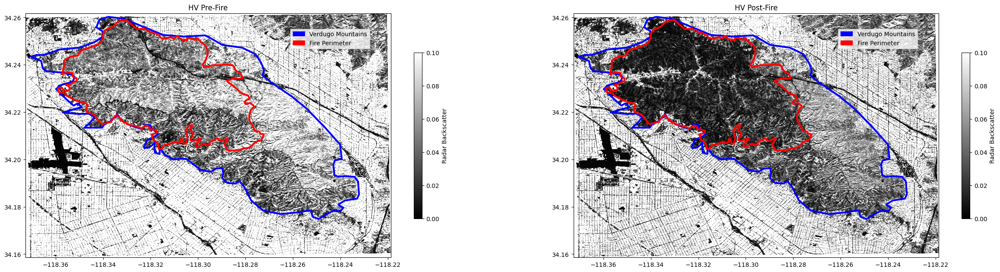

In [20]:
#@title Plot HV Pre and Post Fire
#Function to plot the fire perimeter
def plot_fire(pre_fire_array, post_fire_array, geo_tiff_file, area_perimeter_file, fire_perimeter_file):
    fig, (ax1, ax2 ) = plt.subplots(1, 2, figsize=(30, 10))

    vmin = 0
    vmax = 0.1

    with rio.open(geo_tiff_file) as subset_src:  # getting reference extent
        subset_extent = plotting_extent(subset_src)
        trans = subset_src.transform

    area_perimeter = gpd.read_file(area_perimeter_file)
    area_perimeter = area_perimeter["geometry"]
    area_boundary = area_perimeter.to_crs(subset_src.crs)
    area_boundary.plot(edgecolor='blue', facecolor='none', linewidth=3, ax=ax1)
    area_boundary.plot(edgecolor='blue', facecolor='none', linewidth=3, ax=ax2)

    fire_perimeter = gpd.read_file(fire_perimeter_file)
    fire_perimeter = fire_perimeter["geometry"]
    fire_boundary = fire_perimeter.to_crs(subset_src.crs)
    fire_boundary.plot(edgecolor='red', facecolor='none', linewidth=3, ax=ax1)
    fire_boundary.plot(edgecolor='red', facecolor='none', linewidth=3, ax=ax2)

    # Add a legend for labels
    legend_labels = {"blue": "Verdugo Mountains", "red" : "Fire Perimeter"}
    patches = [Patch(color=color, label=label) for color, label in legend_labels.items()]
    ax1.legend(handles=patches, bbox_to_anchor=(0.95, 0.95), facecolor="white")
    ax2.legend(handles=patches, bbox_to_anchor=(0.95, 0.95), facecolor="white")

    cmap = "gray"
    plot = ax1.imshow(pre_fire.squeeze(), vmin=vmin, vmax=vmax, cmap=cmap, extent=subset_extent)
    ax1.set_title("HV Pre-Fire")
    cbar=fig.colorbar(plot, ax=ax1, shrink=0.5)
    cbar.set_label('Radar Backscatter')

    plot = ax2.imshow(post_fire.squeeze(), vmin=vmin, vmax=vmax, cmap=cmap, extent=subset_extent)
    ax2.set_title("HV Post-Fire")
    cbar=fig.colorbar(plot, ax=ax2, shrink=0.5)
    cbar.set_label('Radar Backscatter')

    plt.show()
########### End of function code ###########


# Function call to plot the fire perimeter
plot_fire(pre_fire, post_fire,'6m_stack.tif','verdugos.geojson', 'latuna_perimeter.geojson')

The plot below displays NISAR simulated HV data for the same post-fire date coverage. NISAR simulated products are generated from UAVSAR data to emulate NISAR data characteristics in order to help users test their algorithms and get a sense of the quality of future NISAR products.

* To learn more about NISAR simulated data characteristics go here: https://uavsar.jpl.nasa.gov/science/documents/nisar-sample-products.html and browse the other available NISAR simulated data by selecting "Simulated NISAR" on the UAVSAR data search page: https://uavsar.jpl.nasa.gov/cgi-bin/data.pl.


* To learn more about all the planned NISAR data products, a short description, a link to where you can download them, go here: https://nisar.jpl.nasa.gov/data/sample-data/



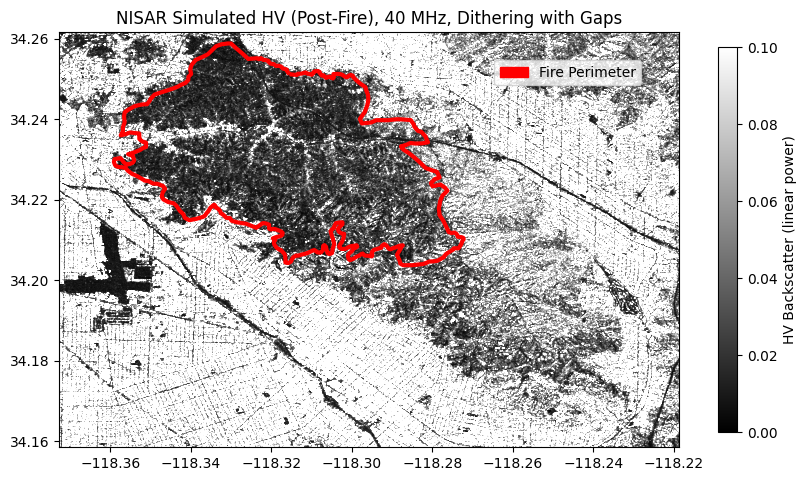

In [24]:
#@title Plot NISAR Simulated Image HV Post Fire

fig, ax1 = plt.subplots(1,1, figsize=(10,10))

vmin = 0
vmax = 0.1

with rio.open('6m_stack.tif') as subset_src: #getting reference extent
    subset_extent = plotting_extent(subset_src)
    trans = subset_src.transform
fire_perimeter = gpd.read_file('latuna_perimeter.geojson')
fire_perimeter = fire_perimeter["geometry"]
fire_boundary = fire_perimeter.to_crs(subset_src.crs)
fire_boundary.plot(edgecolor='red', facecolor='none', linewidth=3, ax=ax1)

# Add a legend for labels
legend_labels = {"red": "Fire Perimeter"}
patches = [Patch(color=color, label=label)
           for color, label in legend_labels.items()]
ax1.legend(handles=patches,
          bbox_to_anchor=(0.95, 0.95),
          facecolor="white")

cmap = "gray"
plot = ax1.imshow(post_fire_nisarsim.squeeze(), vmin=vmin, vmax=vmax, cmap=cmap, extent=subset_extent)
ax1.set_title('NISAR Simulated HV (Post-Fire), 40 MHz, Dithering with Gaps')
cbar=fig.colorbar(plot, ax=ax1, shrink=0.5)
cbar.set_label('HV Backscatter (linear power)')

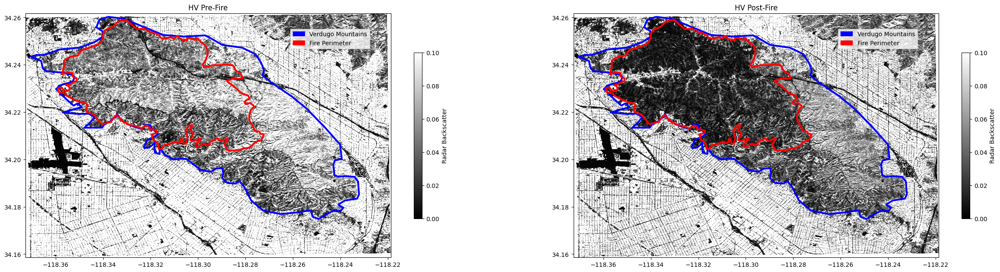

In [21]:
# Function call to plot the fire perimeter
plot_fire(pre_fire_nisarsim, post_fire_nisarsim,'6m_stack.tif','verdugos.geojson', 'latuna_perimeter.geojson')

SAR's HV polarization is used due to HV's sensitivity to vegetation change and transects from images pre and post fire can be used to compare changes in HV backscatter values between areas burnt in the fire and unburnt areas. Burnt areas should have decreased HV backscatter.

The figures below show the fire perimeter (red) and perimeter of the unburned portion of the Verdugo Mountains (blue). HV's sensitivity to vegetation change can be leveraged to map fire extent, and HV values visibly decrease (appear darker) in 2017 after the fire. The figure also shows a transect spanning both the fire scar and unburned regions of the Verdugo Mountains. Their discrepancy highlights how the HV values changed pre and post fire.


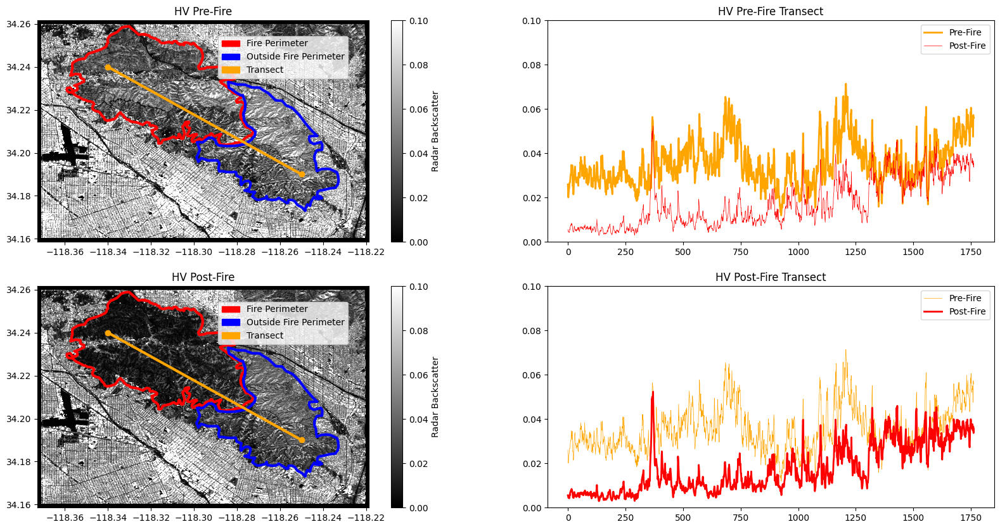

In [7]:
#@title Plot Pre-Fire and Post-Fire with the HV Image

# Specify start/stop of the pixel coordinates for plot transect
x0, y0 = 550, 200
x1, y1 = 2000, 1200
# Generate the transect
transect_prefire = profile_line(hv2014, (y0, x0), (y1, x1), linewidth=100, mode='nearest', reduce_func=np.median)
transect_postfire = profile_line(hv2017, (y0, x0), (y1, x1), linewidth=100, mode='nearest', reduce_func=np.median)

vmin=0
vmax=0.1
x1, y1 = -118.34, 34.24
x0, y0 = -118.25, 34.19
cm = ['viridis','gray']
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(20, 10))

############## Read in the fire and perimeter geometries ##############
with rio.open('stack_fire.tif') as subset_src: #getting reference extent
    subset_extent = plotting_extent(subset_src)
    trans = subset_src.transform
fire_perimeter = gpd.read_file('latuna_perimeter.geojson')
fire_perimeter = fire_perimeter["geometry"]
fire_boundary = fire_perimeter.to_crs(subset_src.crs)
fire_boundary.plot(edgecolor='red', facecolor='none', linewidth=3, ax=axes[0,0])
fire_boundary.plot(edgecolor='red', facecolor='none', linewidth=3, ax=axes[1,0])

verdugos_perimeter = gpd.read_file('unburnt_verdugo.geojson')
verdugos_perimeter = verdugos_perimeter["geometry"]
verdugos_boundary = verdugos_perimeter.to_crs(subset_src.crs)
verdugos_boundary.plot(edgecolor='blue', facecolor='none', linewidth=3, ax=axes[0,0])
verdugos_boundary.plot(edgecolor='blue', facecolor='none', linewidth=3, ax=axes[1,0])

# Add a legend for labels
legend_labels = {"red": "Fire Perimeter", "blue":"Outside Fire Perimeter", "orange":"Transect"}
patches = [Patch(color=color, label=label)
           for color, label in legend_labels.items()]
axes[0,0].legend(handles=patches,
          bbox_to_anchor=(0.95, 0.95),
          facecolor="white")
axes[1,0].legend(handles=patches,
          bbox_to_anchor=(0.95, 0.95),
          facecolor="white")

############## Pre-Fire Plotting ##############
color = axes[0,0].imshow(hv2014, vmin=vmin, vmax=vmax, cmap=cm[1], extent=subset_extent)
axes[0,0].plot([x0, x1], [y0, y1], 'o-', lw=3, color='orange')
axes[0,0].set_title('HV Pre-Fire')
colorbar = fig.colorbar(color, ax=axes[0, 0])
colorbar.set_label('Radar Backscatter')

axes[0,1].plot(transect_prefire, color='orange', linewidth='2')
axes[0,1].plot(transect_postfire, color='red', linewidth='0.5')
axes[0,1].set_ylim([vmin, vmax])
axes[0,1].set_title('HV Pre-Fire Transect')

# Create legend handles for pre-fire and post-fire transect
axes[0, 1].legend(('Pre-Fire', 'Post-Fire'), loc='upper right')

############## Post-Fire Plotting ##############
color = axes[1,0].imshow(hv2017, vmin=vmin, vmax=vmax, cmap=cm[1], extent=subset_extent)
axes[1,0].plot([x0, x1], [y0, y1], 'o-', lw=3, color='orange')
axes[1,0].set_title('HV Post-Fire')
colorbar = fig.colorbar(color, ax=axes[1, 0])
colorbar.set_label('Radar Backscatter')

axes[1,1].plot(transect_prefire, color='orange', linewidth='0.5')
axes[1,1].plot(transect_postfire, color='red', linewidth='2')
axes[1,1].set_ylim([vmin, vmax])
axes[1,1].set_title('HV Post-Fire Transect')
axes[1, 1].legend(('Pre-Fire', 'Post-Fire'), loc='upper right')

plt.show()

##  Time Series
UAVSAR has collected data over the Verdugo Mountains since 2009, and leveraging this dataset, we can generate a time series plot of HV statistics inside and outside the fire scar. This time series plot shows how the mean and spread of HV values changes over time. The 2017 post-fire collection has the lowest mean for the area inside the fire scar, although interestingly this mean quickly increased in 2018, possibly indicating vegetation recovery.

Notably, unburned areas of the Verdugo Mountains also have lower values in 2014 (pre-fire) and 2017 (post-fire), likely due to the severe drought in California during those years.

In [8]:
#@title Prepare Data for Time Series
## Make geodataframe and get raster stats

#The UAVSAR stack read in below was converted from linear power to decibels (dB). Formula: 10*log10(DN)
def convert_db(data):
  db = 10*(math.log(data))
  return db

img = rio.open("stack_fire.tif")
array=img.read()
df = pd.DataFrame(array.reshape([10,-1]).T, columns=['2009', '2010','2011','2012','2014','2017','2018','2020','verdugos','fire'])
verdugos_df = df.loc[df['verdugos'] == 2]
perimeter_df = df.loc[df['fire'] == 1]

pd.options.mode.chained_assignment = None
perimeter_df ['2014'] = perimeter_df['2014'].apply(convert_db)
verdugos_df['2014'] = verdugos_df['2014'].apply(convert_db)
perimeter_df['2017'] = perimeter_df['2017'].apply(convert_db)
verdugos_df['2017'] = verdugos_df['2017'].apply(convert_db)

perimeter_df_stats = perimeter_df.describe().transpose()
verdugos_df_stats = verdugos_df.describe().transpose()
perimeter_df_stats.index.name = 'Year'
perimeter_df_stats.reset_index(inplace=True)
verdugos_df_stats.index.name = 'Year'
verdugos_df_stats.reset_index(inplace=True)

perimeter_df_stats = perimeter_df_stats.iloc[:8]
verdugos_df_stats = verdugos_df_stats.iloc[:8]
perimeter_df_stats

,Year,count,mean,std,min,25%,50%,75%,max
0,2009,745848.0,-20.666151,6.635054,-42.770805,-24.415382,-19.418075,-15.795507,11.251516
1,2010,745848.0,-20.251175,6.523628,-41.617771,-23.895718,-18.954889,-15.451772,11.189482
2,2011,745848.0,-19.737677,5.832297,-37.709297,-23.511009,-18.757696,-15.368543,9.409277
3,2012,745848.0,-19.862925,6.012344,-38.935780,-23.544755,-18.829776,-15.403744,11.662669
4,2014,745848.0,-35.943952,9.146047,-80.215988,-40.663257,-34.550736,-29.680724,22.535265
5,2017,745848.0,-47.139110,10.520229,-79.545094,-54.889456,-47.336536,-39.471302,16.801246
6,2018,745848.0,-22.621531,5.131218,-35.743809,-26.570961,-23.292169,-19.179979,10.638227
7,2020,745848.0,-22.697220,5.277463,-37.655666,-26.460325,-22.920212,-19.033489,8.978511


In [9]:
#@title Plot HV Time Series
# Convert 'Year' column to datetime
perimeter_df_stats['Year'] = pd.to_datetime(perimeter_df_stats['Year'], format='%Y')
verdugos_df_stats['Year'] = pd.to_datetime(verdugos_df_stats['Year'], format='%Y')

fig = go.Figure()
fig.add_trace(go.Scatter(x=perimeter_df_stats["Year"], y=perimeter_df_stats["mean"], name="HV Inside Fire Scar", error_y=dict(
            type='percent', # value of error bar given in data coordinates
            symmetric=False,
            value=50,
            valueminus=50)))
fig.add_trace(go.Scatter(x=verdugos_df_stats["Year"], y=verdugos_df_stats["mean"], name="HV Outside Fire Scar", error_y=dict(
            type='percent', # value of error bar given in data coordinates
            symmetric=False,
            value=50,
            valueminus=50)))
fig.update_xaxes(
    dtick="M1",
    tickformat="\n%Y")
fig.update_layout(
    title="HV Inside vs Outside Fire Scar",
    xaxis_title="Year of UAVSAR Collection",
    yaxis_title="decibels (dB)",
    font=dict(
        family="Courier New, monospace",
        size=18,
        color="Black"))
fig.show()

# Image filtering & Plotting the HV Pre/Post Fire
The images are filtered to supress the speckle noise (high or low frequency image distortions) while emphasizing distinct points and minimizing the loss of texture details on the radar image for better analysis.



In [12]:
# Function to filter the image pixels
# Parameters are either the pre or post fire data stacks (Ex. hv2014, hv2017. The first two stacks created in section 1)
def filter(fire_image):
  image = median(fire_image, selem=np.ones((5, 5)))
  return image
########### End of function code ###########

# Function call & declaring the filtered variable
pre_fire_filtered = filter(pre_fire)
post_fire_filtered = filter(post_fire)

<ipython-input-12-f057d086d92a>:4: FutureWarning:

`selem` is a deprecated argument name for `median`. It will be removed in version 1.0. Please use `footprint` instead.



# HV Log Ratio


Calculate and plot the HV/HV log ratio for pre and post fire UAVSAR acquisitions. For the workflow reference: pg 116 https://gis1.servirglobal.net/TrainingMaterials/SAR/SARHB_FullRes.pdf

We specifically use the HV polarization. HV correlates with biomass and canopy volume and is primarily sensitive to volume scattering. Volume scattering decreases as vegetation is replaced with bare ground after a fire. A simple ratio of HV images pre and post fire show temporal change. Here, we calculate the HV Ratio and compare with dNBR (differenced normalized burn ratio), a widely-used index derived from optical sensors to map burn severity. dNBR is provided for comparison with the HV ratio, as it captures burn area by exploiting the loss of healthy green vegetation, or changes in greenness. Notably, radar is not sensitive to greenness or chemical composition, but instead can detect differences in moisture content, as well as the presence of branches and trunks.

In [50]:
# Function to find the HV log ratio
def HV_log_ratio(pre, post):
  HV_log_pre_post = np.log(np.divide(pre, post))
  return HV_log_pre_post
########### End of function code ###########

HV_log = HV_log_ratio(pre_fire_filtered, post_fire_filtered) # Function call

#HV_diff = pre_fire_filtered - post_fire_filtered

<a name="s3"></a>
# 4. UAVSAR & dNBR Comparison

Plot UAVSAR HV Log Ratio next to BAER's (Burned Area Emergency Response) dNBR (Differenced Normalized Burn Ratio) released fire severity product. The stripes in the dNBR is due to issues with Landsat 7.

The dNBR fire severity product was derived from Landsat 8 and Landsat 7 data.  Pre-fire and post-fire scenes are analyzed to create a differenced Normalized Burn Ratio (dNBR) image. The dNBR image portrays the variation of burn severity within the fire. The pre- and post-fire Landsat images are terrain corrected and corrected to Top of Atmosphere reflectance.

The Normalized Burn Ratio (NBR) is computed for each date of imagery (Landsat 8 bands) using the following formula:

	NBR = (Band 5(NIR) - Band 7(SWIR) / (Band 5 + Band 7)

The Differenced NBR is computed to determine severity by subtracting the post-fire NBR from the pre-fire NBR:

	dNBR = (PreNBR - PostNBR)


The classes represented on the BARC products are created with thresholds chosen by an analyst at USGS EROS. The thresholds used on this particular fire are:

	Unchanged:  -275 to 110
	Low:		115 to 280
	Moderate:   285 to 670
	High:	   675 10000



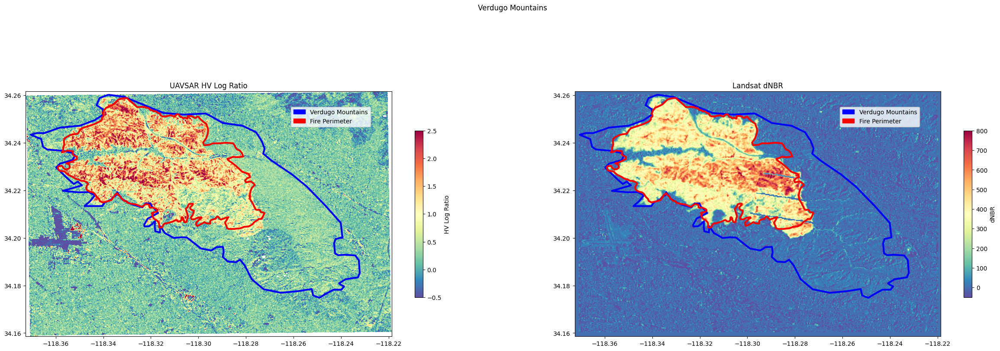

In [25]:
#@title Plot UAVSAR HV Log Ratio and Landsat dNBR
# Function to plot the UAVSAR HV log ratio & BAER dNBR
def plot_hv_log_dnbr(HV_log_ratio, dnbr, geo_tiff_file, area_perimeter_file, fire_perimeter_file, area_name, radar_title, landsat_title):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(30, 10))

    with rio.open(geo_tiff_file) as subset_src:  # getting reference extent
        subset_extent = plotting_extent(subset_src)
        trans = subset_src.transform

    area_perimeter = gpd.read_file(area_perimeter_file)
    area_perimeter = area_perimeter["geometry"]
    area_boundary = area_perimeter.to_crs(subset_src.crs)
    area_boundary.plot(edgecolor='blue', facecolor='none', linewidth=3, ax=ax1)
    area_boundary.plot(edgecolor='blue', facecolor='none', linewidth=3, ax=ax2)


    fire_perimeter = gpd.read_file(fire_perimeter_file)
    fire_perimeter = fire_perimeter["geometry"]
    fire_boundary = fire_perimeter.to_crs(subset_src.crs)
    fire_boundary.plot(edgecolor='red', facecolor='none', linewidth=3, ax=ax1)
    fire_boundary.plot(edgecolor='red', facecolor='none', linewidth=3, ax=ax2)

    # Add a legend for labels
    legend_labels = {"blue": "Verdugo Mountains", "red": "Fire Perimeter"}
    patches = [Patch(color=color, label=label) for color, label in legend_labels.items()]
    ax1.legend(handles=patches, bbox_to_anchor=(0.95, 0.95), facecolor="white")
    ax2.legend(handles=patches, bbox_to_anchor=(0.95, 0.95), facecolor="white")

    # Add general map title
    fig.suptitle(area_name)

    # Map vis parameters
    cmap = "Spectral_r"
    vmin = -0.5
    vmax = 2.5
    args = dict(vmin=vmin, vmax=vmax, cmap=cmap, extent=subset_extent)

    # Plot HV Log Ratio
    plot = ax1.imshow(HV_log_ratio.squeeze(), **args)
    ax1.set_title(radar_title)
    cbar=fig.colorbar(plot, ax=ax1, shrink=0.5)
    cbar.set_label('HV Log Ratio')

    # Plot dNBR
    plot = ax2.imshow(dnbr.squeeze(), vmin=-50, vmax=800, cmap=cmap, extent=subset_extent)
    ax2.set_title(landsat_title)
    cbar=fig.colorbar(plot, ax=ax2, shrink=0.5)
    cbar.set_label('dNBR')

    plt.show()
########### End of function code ###########

# Function call
plot_hv_log_dnbr(HV_log, dnbr, '6m_stack.tif', 'verdugos.geojson', 'latuna_perimeter.geojson', 'Verdugo Mountains', 'UAVSAR HV Log Ratio', 'Landsat dNBR')

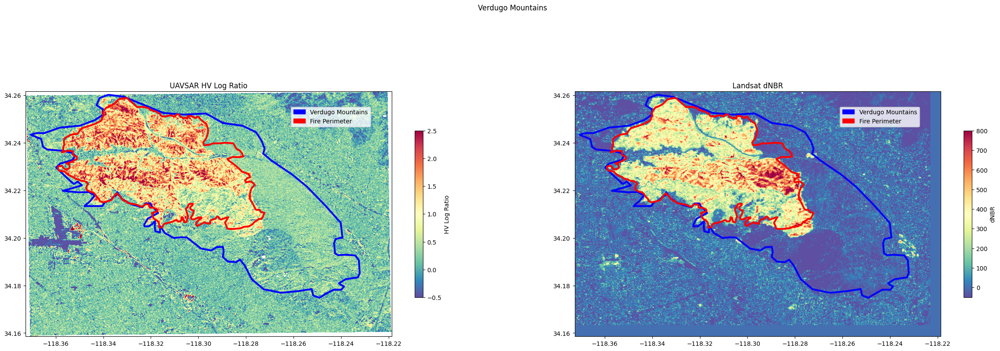

In [26]:
# Function call (UAVSAR & Landsat dNBR matching UAVSAR dates)
plot_hv_log_dnbr(HV_log, dnbr_uavsar_dates, '6m_stack.tif', 'verdugos.geojson', 'latuna_perimeter.geojson', 'Verdugo Mountains', 'UAVSAR HV Log Ratio', 'Landsat dNBR')

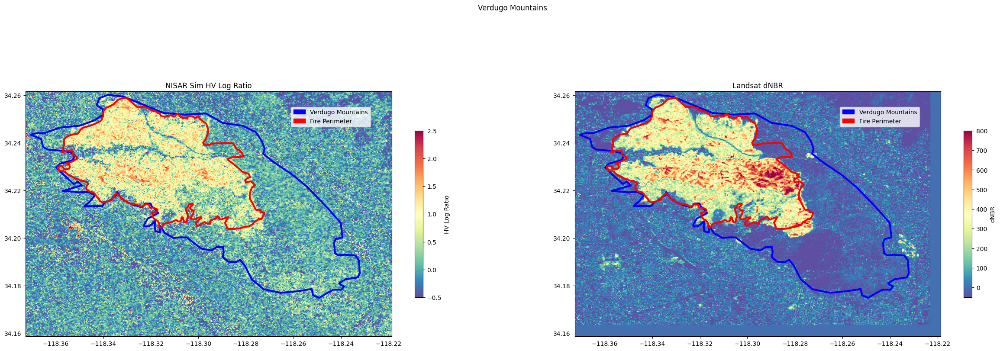

In [27]:
plot_hv_log_dnbr(hvlog_nisarsim, dnbr_uavsar_dates, '6m_stack.tif', 'verdugos.geojson', 'latuna_perimeter.geojson', 'Verdugo Mountains', 'NISAR Sim HV Log Ratio', 'Landsat dNBR')

The two figures above displays the classification of the burn severity with a scale on the right hand side to depict a burn map of the La Tuna fire using  UAVSAR HV Log Ratio and the Landsat dNBR.

In [28]:
# Function for combining the two arrays into one single band image
# Parameter is the data file created in Section 3
# Data file paramteter is when the filter is applied to the pre/post fire (Ex. HV_log)
def combine_array(data):
  combined = data[area_burned != 0] # verdugos varaible is the full image array (See the last stack created)
  combined[combined ==0] = np.nan
  return combined

combine_array(HV_log) # Function call

array([0.25182444, 0.47191784, 0.5119459 , ..., 0.3443554 , 0.3443554 ,
       0.32119328], dtype=float32)

# 5. Thresholding
Gaussian Mixture Modeling was employed to determine suitable thresholds for distinguishing burned and unburned pixels, assuming the presence of two Gaussian curves.

In [29]:
# Histogram
# Reshape the combined array
X = combine_array(HV_log).reshape(-1, 1)
X_cleaned = X[~np.isnan(X).any(axis=1)]
gm = GaussianMixture(n_components=2, random_state=0).fit(X_cleaned)

# Evaluate GMM
x_axis = np.arange(-1, 4, 0.001)
gmm_y = np.exp(gm.score_samples(x_axis.reshape(-1,1)))


# Function to plot the gaussian mixture model
def plot_hist(x_axis, y_axis_gaussian_mixture):
  # Plot histograms and gaussian curves
  fig = go.Figure()

  # Create histogram trace
  hist_trace = go.Histogram(x=combine_array(HV_log), nbinsx=200, histnorm='probability density', name='HV')

  # Create gaussian curve trace
  gmm_trace = go.Scatter(x=x_axis, y=y_axis_gaussian_mixture, mode='lines', name='Gaussian Mixture Model')

  # Plot labels
  fig.update_layout(xaxis_title="HV Log Ratio", yaxis_title="Density", title="Distribution of HV Log Data and Gaussian Mixture Model")

  # Add traces to the figure
  fig.add_trace(hist_trace)
  fig.add_trace(gmm_trace)

  # Show the figure
  fig.show()

plot_hist(x_axis, gmm_y)

Use the GMM covariance to calculate the standard deviation.

In [30]:
# Calculates the GM output means (standard deviation from the covariance of the first and second curve
# Prints the covariances of the pixels.

# Get the means and covariances from the GMM
means = gm.means_.flatten()
cov = gm.covariances_

# Sort the means and covariances together
sorted_indices = np.argsort(means)
means_sorted = means[sorted_indices]
cov_sorted = cov[sorted_indices]

# Assign the means and covariances to mean1, mean2, stddev1, and stddev2
mean1, mean2 = means_sorted[0], means_sorted[1]

# Calculate first curve's standard deviation from the covariance
stddev1 = np.sqrt(np.trace(cov_sorted[0]) / 2)

# Calculate second curve's standard deviation from the covariance
stddev2 = np.sqrt(np.trace(cov_sorted[1]) / 2)

print('mean1 (burned curve from GM):', mean1)
print('mean2 (not burned curve from GM):', mean2)
print('stddev1:', round(stddev1, 4))
print('stddev2:', round(stddev2, 4))

mean1 (burned curve from GM): 0.3206795372467661
mean2 (not burned curve from GM): 1.5473989533517416
stddev1: 0.2425
stddev2: 0.3643


In [31]:
from scipy.stats import norm
x_notburned = np.linspace(-1, 3, 100)
y_notburned = norm.pdf(x_notburned, mean1, stddev1)
x_burned = np.linspace(-1, 3, 100)
y_burned = norm.pdf(x_burned, mean2, stddev2)

# Function for plotting the histogram of the two curves.
# Parameters are the not burned and burned pixels x/y axis
def plot_hist(x_burned, y_burned, x_notBurned, y_notBurned):

  # Create traces
  fig = go.Figure()

  # Plots the burned line
  fig.add_trace(go.Scatter(x=x_burned, y=y_burned, mode='lines', name='Burned Curve'))

  # Plots the not burned line
  fig.add_trace(go.Scatter(x=x_notBurned, y=y_notBurned, mode='lines', name='Not Burned Curve'))

  # Axis labels
  fig.update_layout(xaxis_title="HV Log Ratio", yaxis_title="Density", title="Gaussian Curves of Burned & Not Burned UAVSAR Data ")

  # Displays the histogram
  fig.show()

# Function call
plot_hist(x_burned, y_burned, x_notburned, y_notburned)

Find the burned and high severity thresholds

In [32]:
y_notburned = norm.cdf(x_notburned, mean1, stddev1)
y_burned = norm.cdf(x_burned, mean2, stddev2)

burned_threshold = x_notburned[y_notburned>0.95][0]
high_severity_threshold = x_burned[y_burned>0.95][0]
print('Burned Threshold:', round(burned_threshold, 4)," | ", 'High Severity Threshold:', round(high_severity_threshold, 4))

Burned Threshold: 0.7374  |  High Severity Threshold: 2.1515


In [43]:
combine_array(HV_log)

HV_log_burned = HV_log[perimeter != 0]
HV_log_notburned = HV_log[area_burned != 0]
hvlog_combined = np.concatenate((HV_log_burned , HV_log_notburned));

dnbr_burned = np.multiply(dnbr, perimeter)
dnbr_burned[dnbr_burned==-9999] = np.nan
dnbr_burned[dnbr_burned==0] = np.nan
dnbr_notburned = np.multiply(dnbr, area_burned)
dnbr_notburned[dnbr_notburned==-9999] = np.nan
dnbr_notburned[dnbr_notburned==0] = np.nan

dnbr_combined = np.concatenate((dnbr_burned, dnbr_notburned));

In [36]:
#@title dNBR Gaussian Thresholing
# # Reshape the combined array
# X = combine_array(dnbr).reshape(-1, 1)
# X_cleaned = X[~np.isnan(X).any(axis=1)]
# gm = GaussianMixture(n_components=2, random_state=0).fit(X_cleaned)

# # Evaluate GMM
# x_axis = np.arange(-400, 800, 0.01)
# gmm_y = np.exp(gm.score_samples(x_axis.reshape(-1,1)))

# # Function to plot the gaussian mixture model
# def plot_hist(x_axis, y_axis_gaussian_mixture):
#   # Plot histograms and gaussian curves
#   fig = go.Figure()

#   # Create histogram trace
#   hist_trace = go.Histogram(x=combine_array(dnbr), nbinsx=200, histnorm='probability density', name='HV')

#   # Create gaussian curve trace
#   gmm_trace = go.Scatter(x=x_axis, y=y_axis_gaussian_mixture, mode='lines', name='Gaussian Mixture Model')

#   # Plot labels
#   fig.update_layout(xaxis_title="HV Log Ratio", yaxis_title="Density", title="Distribution of HV Log Data and Gaussian Mixture Model")

#   # Add traces to the figure
#   fig.add_trace(hist_trace)
#   fig.add_trace(gmm_trace)

#   # Show the figure
#   fig.show()

# plot_hist(x_axis, gmm_y)

# #########################################################################################################################
# # Calculates the GM output means (standard deviation from the covariance of the first and second curve
# # Prints the covariances of the pixels.

# # Get the means and covariances from the GMM
# means = gm.means_.flatten()
# cov = gm.covariances_

# # Sort the means and covariances together
# sorted_indices = np.argsort(means)
# means_sorted = means[sorted_indices]
# cov_sorted = cov[sorted_indices]

# # Assign the means and covariances to mean1, mean2, stddev1, and stddev2
# mean1, mean2 = means_sorted[0], means_sorted[1]

# # Calculate first curve's standard deviation from the covariance
# stddev1 = np.sqrt(np.trace(cov_sorted[0]) / 2)

# # Calculate second curve's standard deviation from the covariance
# stddev2 = np.sqrt(np.trace(cov_sorted[1]) / 2)

# print('mean1 (burned curve from GM):', mean1)
# print('mean2 (not burned curve from GM):', mean2)
# print('stddev1:', round(stddev1, 4))
# print('stddev2:', round(stddev2, 4))

# #########################################################################################################################
# from scipy.stats import norm
# x_notburned = np.linspace(-400, 800, 100)
# y_notburned = norm.pdf(x_notburned, mean1, stddev1)
# x_burned = np.linspace(-400, 800, 100)
# y_burned = norm.pdf(x_burned, mean2, stddev2)

# # Function for plotting the histogram of the two curves.
# # Parameters are the not burned and burned pixels x/y axis
# def plot_hist(x_burned, y_burned, x_notBurned, y_notBurned):

#   # Create traces
#   fig = go.Figure()

#   # Plots the burned line
#   fig.add_trace(go.Scatter(x=x_burned, y=y_burned, mode='lines', name='Burned Curve'))

#   # Plots the not burned line
#   fig.add_trace(go.Scatter(x=x_notBurned, y=y_notBurned, mode='lines', name='Not Burned Curve'))

#   # Axis labels
#   fig.update_layout(xaxis_title="HV Log Ratio", yaxis_title="Density", title="Gaussian Curves of Burned & Not Burned UAVSAR Data ")

#   # Displays the histogram
#   fig.show()

# # Function call
# plot_hist(x_burned, y_burned, x_notburned, y_notburned)

# #########################################################################################################################
# y_notburned = norm.cdf(x_notburned, mean1, stddev1)
# y_burned = norm.cdf(x_burned, mean2, stddev2)

# burned_threshold = x_notburned[y_notburned>0.95][0]
# high_severity_threshold = x_burned[y_burned>0.95][0]
# print('Burned Threshold:', round(burned_threshold, 4)," | ", 'High Severity Threshold:', round(high_severity_threshold, 4))

UAVSAR:
The threshold for 0.25 percentile under the curve is: 0.20999999344348907
The threshold for 0.9 percentile under the curve is: 1.784999966621399
The threshold for 0.95 percentile under the curve is: 2.055000066757202
Landsat:
The threshold for 0.95 percentile under the curve is: 696.0
The threshold for 0.25 percentile under the curve is: 24.0
The threshold for 0.9 percentile under the curve is: 582.0


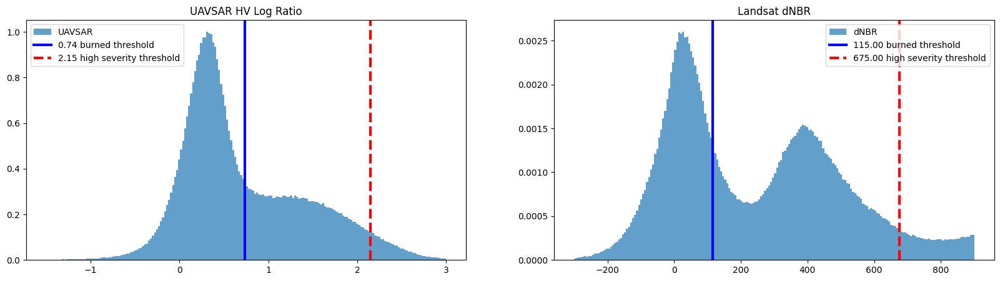

In [40]:
#@title UAVSAR & dNBR Histograms

# Function to find the area under the curve & plot a line
def area_under_curve(axes, bins, value, counts, color, ls, label):
  # Find bin corresponding to percent value
  array = np.asarray(value)
  # Return indices of bins of array value
  index = np.digitize(array, bins) - 1
  # Calculate area under hist after value
  bin_width = np.diff(bins)[0]
  area = sum(bin_width * counts[:index])
  # Add area line
  axes.axvline(value, color=color, linewidth=3, ls=ls, label=f"{value:.2f} {label}")
  axes.legend()

# Function to find the index for a specific area under the histogram's curve
def area(bins, height, value):
  # Find width of histogram bins
  bin_width = np.diff(bins)[0]
  # Get the area of each bin
  area = height * bin_width
  # Find the cumulative sum of the bins
  cumsum = np.cumsum(area)
  # Find the bin index where the cumulative area equals the input value
  array = np.asarray(value)
  index = np.digitize(array, cumsum)
  print("The threshold for " + str(value) + " percentile under the curve is: " + str(bins[index]))

# Function to plot the histograms
def plot_hists(HV_log_array, fire_perimeter, burned_area, dNBR_array):
  fig, (ax1, ax2)  = plt.subplots(1,2, figsize=(20,5))

  ######################### Histograms #########################
  ########## UAVSAR 6 meter#############
  n, bins, patches = ax1.hist(X.flatten(), range = [-1.5, 3], bins=200, alpha=0.7, density=True,label='UAVSAR')
  x_axis = np.arange(-5, 5, 0.001)
  ax1.set_title("UAVSAR HV Log Ratio")
  print("UAVSAR:")
  # Find threshold for top 5% of the not burned area
  area(bins, n, 0.25)
  # Find threshold for top 10% of the burnned area
  area(bins, n, 0.90)
  # Find threshold for top 5% of the burned area
  area(bins, n, 0.95)

  # Plot a line showing burned threshold
  area_under_curve(ax1, bins, burned_threshold, n, ls='-', color="b", label="burned threshold")
  # Plot a line showing high severity threshold
  area_under_curve(ax1, bins, high_severity_threshold, n, ls='--', color="r", label="high severity threshold")

  ########## dNBR 6 meter############
  n, bins, patches = ax2.hist(dnbr_combined.flatten(), bins=200, range = [-300, 900], alpha=0.7, density=True,label="dNBR")
  ax2.set_title("Landsat dNBR")
  print("Landsat:")
  # Find threshold for top 5% of the not burned area
  area(bins, n, 0.95)
  # Find threshold for top 5% of the not burned area
  area(bins, n, 0.25)
  # Find threshold for top 10% of the burned area
  area(bins, n, 0.90)

  # dNBR low burn threshold
  area_under_curve(ax2, bins, 115, n, ls='-', color="b",label="burned threshold")
  # dNBR high burn threshold
  area_under_curve(ax2, bins, 675, n, ls='--', color="r",label="high severity threshold")

# Function call, the parameters are the resulting HV log ratio array & the created array stacks in section 1
plot_hists(HV_log, perimeter, area_burned, dnbr_combined)


In [ ]:
# @title Scatterplot UAVSAR vs Landsat
from scipy import stats

# Assuming combine_array() is a function that combines arrays
# and dnbr_combined is your dNBR data
y = combine_array(HV_log)
x = combine_array(dnbr)

# Remove NaN values from x and y using boolean indexing
mask = ~np.isnan(x) & ~np.isnan(y)
x = x[mask]
y = y[mask]

# Randomly sample 10,000 points for faster plotting (adjust the sample size as needed)
sample_indices = np.random.choice(len(x), size=20000, replace=False)
x_sampled = x[sample_indices]
y_sampled = y[sample_indices]

# Compute density using an approximate KDE
z_sampled = stats.gaussian_kde(x_sampled)(x_sampled)

# Obtain m (slope) and b (intercept) of the linear regression line
m, b = np.polyfit(x_sampled, y_sampled, 1)

# Compute Pearson's correlation coefficient
pearson_corr = np.corrcoef(x_sampled, y_sampled)[0, 1]

# Scatter plot
fig = go.Figure()
fig.add_trace(go.Scatter(x=x_sampled, y=y_sampled, mode='markers', marker=dict(color=z_sampled, size=5), name='Data'))
fig.add_trace(go.Scatter(x=x_sampled, y=m*x_sampled+b, mode='lines', line=dict(color='red'), name='Linear Fit'))
fig.update_layout(
    title='HV Log Ratio vs dNBR',
    xaxis_title='dNBR',
    yaxis_title='HV Log Ratio',
)

# Annotate Pearson's correlation coefficient on the graph
fig.add_annotation(
    x=0.05,
    y=0.95,
    text=f"Pearson's R = {pearson_corr:.3f}",
    showarrow=False,
    xref='paper',
    yref='paper',
    font=dict(size=14),
)

fig.show()


# 6. Fire Severity Classification

UAVSAR and Landsat fire severity classifications of unburned, moderately burned, and high burn severity.

For dNBR, see one clear area of high severity, while UAVSAR seems to show two areas of high severity. There's one clear area of disagreemnt in North (UAVSAR high intensity) and East (dNBR high intensity)


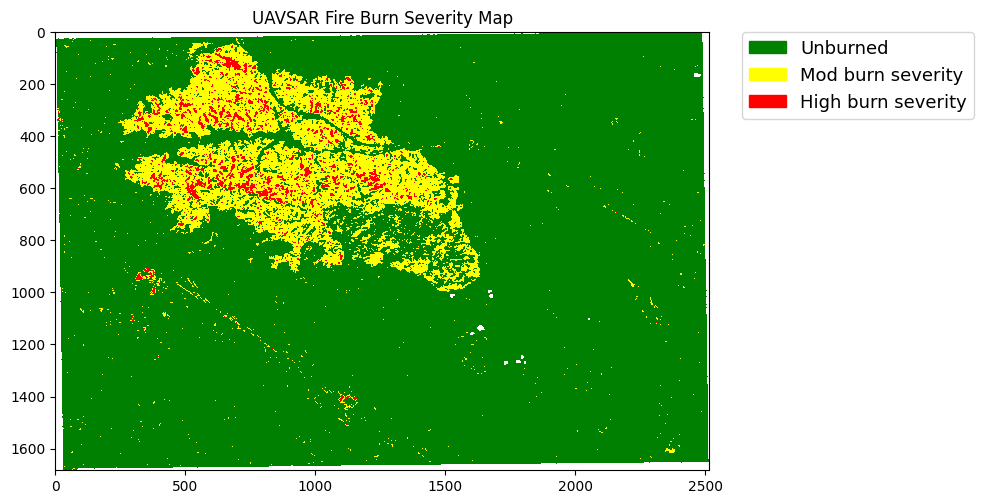

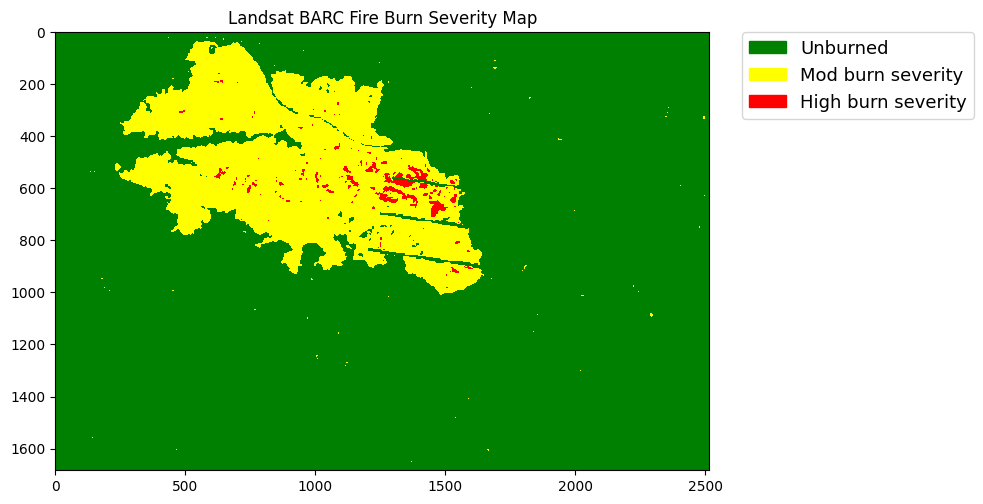

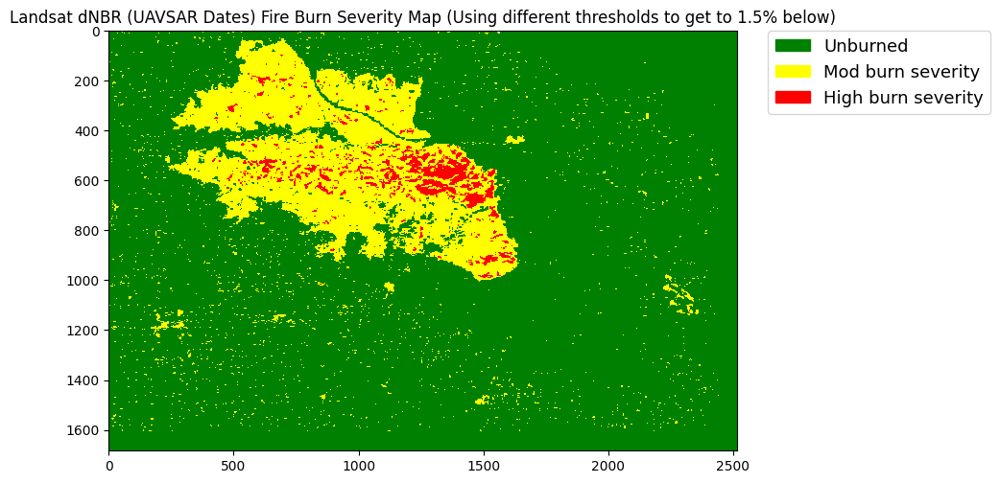

In [44]:
# @title Plot UAVSAR and Landsat Fire Severity Classifications
# Using the identified thresholds make two plots.
# The left plot should show UAVSAR's fire severity classification where when x < burned_threshold is green, burned_threshold < x < severity_threshold is yellow, and x > severity_threshold is red
# The right plot should be the same but using dNBR and dNBR's thresholds

################## UAVSAR plot ##################

# Separate into 4 classes depending on threshold
burn_thresh_hv = burned_threshold
severity_thresh_hv = high_severity_threshold
hv = HV_log.copy()
hv_class = HV_log.copy()

#High Burn Severity UAVSAR (above high severity threshold)
hv_class[hv > severity_thresh_hv] = 30

# Moderate Burn Severity UAVSAR (above burned threshold and below high severity threshold)
hv_class[(hv < severity_thresh_hv) & (hv >= burn_thresh_hv)] = 20

# Unburned UAVSAR (below burned threshold)
hv_class[hv < burn_thresh_hv] = 10

# Remaining scenarios ignored
hv_class[hv_class < 10] = np.nan

# Define the colors you want
cmap = ListedColormap(["green", "yellow", "red"])

# Define a normalization from values -> colors
norm = colors.BoundaryNorm([0, 2, 10, 20, 30], 5)
f, ax = plt.subplots(figsize=(10, 10))
im = ax.imshow(hv_class, cmap = cmap)

ep.draw_legend(im, titles=["Unburned", "Mod burn severity", "High burn severity"], classes=[10, 20, 30])

# Add general map title
plt.title("UAVSAR Fire Burn Severity Map")
plt.tight_layout()

################## DNBR plot ##################
# Function to add a GeoTiff file
dnbr = dnbr
dnbr_class = dnbr.copy()
burn_thresh_dnbr = 115
severity_thresh_dnbr = 675

#High Burn Severity DNBR (above high severity threshold)
dnbr_class[np.where(dnbr > severity_thresh_dnbr)] = 30

# Unburned DNBR (below burned threshold)
dnbr_class[np.where(dnbr < burn_thresh_dnbr)] = 10

# Moderate Burn Severity DNBR (above burned threshold and below high severity threshold)
dnbr_class[np.where((dnbr < severity_thresh_dnbr) & (dnbr >= burn_thresh_dnbr))] = 20

# Remaining scenarios ignored
dnbr_class[dnbr_class < 10] = np.nan

# Define the colors you want
cmap = ListedColormap(["green", "yellow", "red"])

# Define a normalization from values -> colors
norm = colors.BoundaryNorm([0, 2, 10, 20, 30], 5)
f, ax = plt.subplots(figsize=(10, 10))
im = ax.imshow(dnbr_class, cmap = cmap)
ep.draw_legend(im, titles=["Unburned", "Mod burn severity", "High burn severity"], classes=[10, 20, 30])

# Add general map title
plt.title("Landsat BARC Fire Burn Severity Map")
plt.tight_layout()

################## DNBR plot (UAVSAR Dates) ##################
# Function to add a GeoTiff file
dnbr_class = dnbr_uavsar_dates.copy()
burn_thresh_dnbr = 115
severity_thresh_dnbr = 610

#High Burn Severity DNBR (above high severity threshold)
dnbr_class[np.where(dnbr_uavsar_dates > severity_thresh_dnbr)] = 30

# Unburned DNBR (below burned threshold)
dnbr_class[np.where(dnbr_uavsar_dates < burn_thresh_dnbr)] = 10

# Moderate Burn Severity DNBR (above burned threshold and below high severity threshold)
dnbr_class[np.where((dnbr_uavsar_dates < severity_thresh_dnbr) & (dnbr_uavsar_dates >= burn_thresh_dnbr))] = 20

# Remaining scenarios ignored
dnbr_class[dnbr_class < 10] = np.nan

# Define the colors you want
cmap = ListedColormap(["green", "yellow", "red"])

# Define a normalization from values -> colors
norm = colors.BoundaryNorm([0, 2, 10, 20, 30], 5)
f, ax = plt.subplots(figsize=(10, 10))
im = ax.imshow(dnbr_class, cmap = cmap)
ep.draw_legend(im, titles=["Unburned", "Mod burn severity", "High burn severity"], classes=[10, 20, 30])

# Add general map title
plt.title("Landsat dNBR (UAVSAR Dates) Fire Burn Severity Map (Using different thresholds to get to 1.5% below)")
plt.tight_layout()

In [45]:
#@title Fire Severity Classification Summary Table
def get_colored_text(text, color_code):
    return f"{color_code}{text}\033[0m"

# Replace 'your_array' with the actual array you want to summarize
your_array = hv_class

# Define a dictionary to map each class to its color code
class_colors = {
    30: "\033[48;5;196m",  # Red
    20: "\033[48;5;11m",  # Yellow
    10: "\033[48;5;70m",  # Green
}

def assign_names(value):
    # Define the mapping of values to names
    value_name = {
        30: "High Severity ",
        20: "Moderate Severity",
        10: "Unburned",
    }
    return value_name.get(value, f"Value {value}")

# Calculate the unique values and their counts in the array
unique_values, value_counts = np.unique(your_array, return_counts=True)

# Calculate the total count
total_count = np.sum(value_counts)

# Create a list of rows for the table
table_rows = []
for value, count in zip(unique_values, value_counts):
    color_code = class_colors.get(value, "\033[0m")  # Default to the default color
    colored_value = get_colored_text(f"Value {value}", color_code)
    percentage = (count / total_count) * 100
    value_name = assign_names(value)
    #colored_value_name = get_colored_text(f"{value_name}", color_code)
    table_rows.append([colored_value, value_name, count,f"{percentage:.2f}%"])

# Print the summary report as a nicely formatted table
print("UAVSAR Summary Report:")
print(tabulate(table_rows, headers=["Reclass Values","Class", "Pixel Count", "Percent Coverage"], tablefmt="grid"))


###################

def get_colored_text(text, color_code):
    return f"{color_code}{text}\033[0m"

# Replace 'your_array' with the actual array you want to summarize
your_array = dnbr_class

# Define a dictionary to map each class to its color code
class_colors = {
    30: "\033[48;5;196m",  # Red
    20: "\033[48;5;11m",  # Yellow
    10: "\033[48;5;70m",  # Green
}

def assign_names(value):
    # Define the mapping of values to names
    value_name = {
        30: "High Severity ",
        20: "Moderate Severity",
        10: "Unburned",
    }
    return value_name.get(value, f"Value {value}")

# Calculate the unique values and their counts in the array
unique_values, value_counts = np.unique(your_array, return_counts=True)

# Calculate the total count
total_count = np.sum(value_counts)

# Create a list of rows for the table
table_rows = []
for value, count in zip(unique_values, value_counts):
    color_code = class_colors.get(value, "\033[0m")  # Default to the default color
    colored_value = get_colored_text(f"Value {value}", color_code)
    percentage = (count / total_count) * 100
    value_name = assign_names(value)
    #colored_value_name = get_colored_text(f"{value_name}", color_code)
    table_rows.append([colored_value, value_name, count,f"{percentage:.2f}%"])

# Print the summary report as a nicely formatted table
print(" ")
print("Landsat Summary Report:")
print(tabulate(table_rows, headers=["Reclass Values","Class", "Pixel Count", "Percent Coverage"], tablefmt="grid"))

UAVSAR Summary Report:
+------------------+-------------------+------------------+--------------------+
| Reclass Values   | Class             |      Pixel Count | Percent Coverage   |
+==================+===================+==================+====================+
| Value 10.0       | Unburned          |      3.46286e+06 | 81.73%             |
+------------------+-------------------+------------------+--------------------+
| Value 20.0       | Moderate Severity | 600207           | 14.17%             |
+------------------+-------------------+------------------+--------------------+
| Value 30.0       | High Severity     |  65141           | 1.54%              |
+------------------+-------------------+------------------+--------------------+
| Value nan        | Value nan         | 108731           | 2.57%              |
+------------------+-------------------+------------------+--------------------+
 
Landsat Summary Report:
+------------------+-------------------+------------------+-

# 7. Reclassify

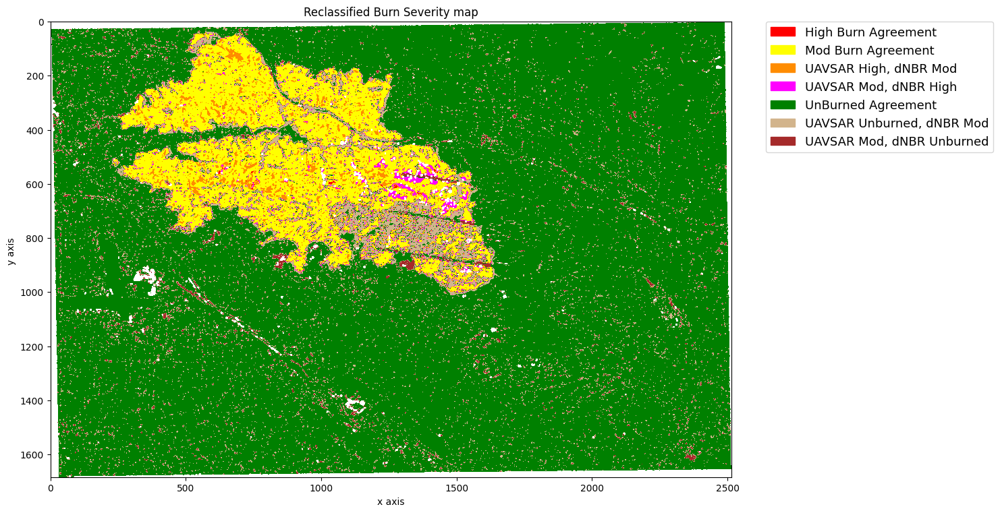

In [46]:
#@title Reclassify with Thresholds and Plot Reclassified Data
# Separate into 4 classes depending on threshold
burn_thresh_dnbr = 115
burn_thresh_hv = burned_threshold
severity_thresh_dnbr = 675
severity_thresh_hv = high_severity_threshold

hv = HV_log
dnbr = dnbr.copy()
hv_reclass = HV_log.copy()

# High Burn UAVSAR, Mod Burn dNBR
hv_reclass[np.where((hv >= severity_thresh_hv) & ((dnbr <= severity_thresh_dnbr) & (dnbr >= burn_thresh_dnbr)))] = 30

# High Burn UAVSAR, High Burn dNBR
hv_reclass[np.where((hv >= severity_thresh_hv) & (dnbr >= severity_thresh_dnbr))] = 10
# Mod Burn UAVSAR, Mod Burn dNBR
hv_reclass[np.where(((hv <= severity_thresh_hv) & (hv >= burn_thresh_hv)) & ((dnbr <= severity_thresh_dnbr) & (dnbr >= burn_thresh_dnbr)))] = 20

# # High Burn UAVSAR, Mod Burn dNBR
#hv_reclass[np.where((hv >= severity_thresh_hv) & ((dnbr <= severity_thresh_dnbr) & (dnbr >= burn_thresh_dnbr)))] = 30
# Mod Burn UAVSAR, High Burn dNBR
hv_reclass[np.where(((hv <= severity_thresh_hv) & (hv >= burn_thresh_hv)) & (dnbr >= severity_thresh_dnbr))] = 40

# Low Burned Agreement: Less than HV & dNBR Threshold
hv_reclass[np.where((hv <= burn_thresh_hv) & (dnbr <= burn_thresh_dnbr))] = 50
# Low Burn UAVSAR, Med Burn dNBR
hv_reclass[np.where((hv <= burn_thresh_hv) & ((dnbr <= severity_thresh_dnbr) & (dnbr >= burn_thresh_dnbr)))] = 60
# Mod Burn UAVSAR, Low Burn dNBR
hv_reclass[np.where((dnbr <= burn_thresh_dnbr) & ((hv <= severity_thresh_hv) & (hv >= burn_thresh_hv)))] = 70

# Remaining scenarios ignored
hv_reclass[np.where(hv_reclass < 10)] = np.nan

# Define the colors you want
cmap = ListedColormap(["red", "yellow", "darkorange", "magenta", "green", "tan", "brown"])

# Define a normalization from values -> colors
norm = colors.BoundaryNorm([0, 2, 10, 20, 30], 5)

f, ax = plt.subplots(figsize=(15, 15))
im = ax.imshow(hv_reclass, cmap = cmap)
ep.draw_legend(im, titles=["High Burn Agreement","Mod Burn Agreement", "UAVSAR High, dNBR Mod", "UAVSAR Mod, dNBR High", "UnBurned Agreement", "UAVSAR Unburned, dNBR Mod", "UAVSAR Mod, dNBR Unburned"],
               classes=[10, 20, 30, 40, 50, 60, 70])

# Add general map title
plt.title("Reclassified Burn Severity map")

# Labels
plt.xlabel("x axis")
plt.ylabel("y axis ")

plt.tight_layout()

In [47]:
#@title Severity Comparison Summary Table
def get_colored_text(text, color_code):
    return f"{color_code}{text}\033[0m"

# Replace 'your_array' with the actual array you want to summarize
your_array = hv_reclass

# Define a dictionary to map each class to its color code
class_colors = {
    10: "\033[48;5;196m",  # Red
    20: "\033[48;5;11m",  # Yellow
    30: "\033[48;5;208m",  # Orange
    40: "\033[48;5;165m",  # Magenta
    50: "\033[48;5;70m",  # Green
    60: "\033[48;5;222m",  # Light Brown
    70: "\033[48;5;94m",  # Brown
}

def assign_names(value):
    # Define the mapping of values to names
    value_name = {
        10: "High Severity Agreement",
        20: "Moderate Severity Agreement",
        30: "High UAVSAR, Mod dNBR",
        40: "Mod UAVSAR, High dNBR",
        50: "Unburned Agreement",
        60: "Low UAVSAR, Mod dNBR",
        70: "Mod UAVSAR, Low dNBR"
    }
    return value_name.get(value, f"Value {value}")

# Calculate the unique values and their counts in the array
unique_values, value_counts = np.unique(your_array, return_counts=True)

# Calculate the total count
total_count = np.sum(value_counts)

# Create a list of rows for the table
table_rows = []
for value, count in zip(unique_values, value_counts):
    color_code = class_colors.get(value, "\033[0m")  # Default to the default color
    colored_value = get_colored_text(f"Value {value}", color_code)
    percentage = (count / total_count) * 100
    value_name = assign_names(value)
    #colored_value_name = get_colored_text(f"{value_name}", color_code)
    table_rows.append([colored_value, value_name, count,f"{percentage:.2f}%"])

# Print the summary report as a nicely formatted table
print("Summary Report:")
print(tabulate(table_rows, headers=["Reclass Values","Class", "Pixel Count", "Percent Coverage"], tablefmt="grid"))

Summary Report:
+------------------+-----------------------------+------------------+--------------------+
| Reclass Values   | Class                       |      Pixel Count | Percent Coverage   |
+==================+=============================+==================+====================+
| Value 10.0       | High Severity Agreement     |   1651           | 0.04%              |
+------------------+-----------------------------+------------------+--------------------+
| Value 20.0       | Moderate Severity Agreement | 458051           | 10.81%             |
+------------------+-----------------------------+------------------+--------------------+
| Value 30.0       | High UAVSAR, Mod dNBR       |  59323           | 1.40%              |
+------------------+-----------------------------+------------------+--------------------+
| Value 40.0       | Mod UAVSAR, High dNBR       |  17688           | 0.42%              |
+------------------+-----------------------------+------------------+-----

# Time Series

In [48]:
stack = rio.open('stack_fire.tif')
stack = stack.read((1,2,3,4,5,6,7,8,9,10))

# Read in stack's bands
hv2009 = stack[0, 0:, 0:]
hv2010 = stack[1, 0:, 0:]
hv2011 = stack[2, 0:, 0:]
hv2012 = stack[3, 0:, 0:]
hv2014 = stack[4, 0:, 0:]
hv2014[hv2014 == -9999] = np.nan
hv2014 = 10 * np.log10(hv2014)
hv2017 = stack[5, 0:, 0:]
hv2017[hv2017 == -9999] = np.nan
hv2017 = 10 * np.log10(hv2017)
hv2018 = stack[6, 0:, 0:]
hv2020 = stack[7, 0:, 0:]

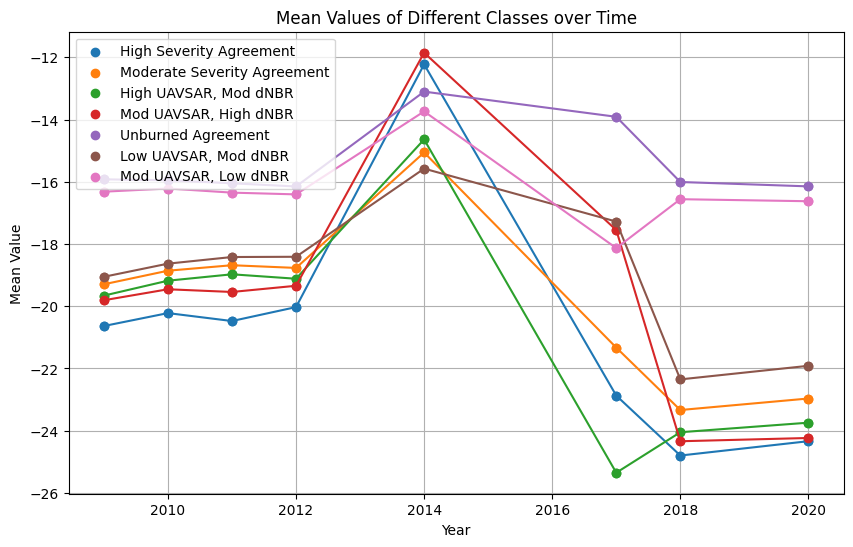

In [49]:
years = (2009, 2010, 2011, 2012, 2014, 2017, 2018, 2020)
class_means = {10: [], 20: [], 30: [], 40:[], 50:[], 60:[], 70:[]}

class_labels = {
        10: "High Severity Agreement",
        20: "Moderate Severity Agreement",
        30: "High UAVSAR, Mod dNBR",
        40: "Mod UAVSAR, High dNBR",
        50: "Unburned Agreement",
        60: "Low UAVSAR, Mod dNBR",
        70: "Mod UAVSAR, Low dNBR"
}

for year in years:
  raster_data = locals()[f'hv{year}']
  for class_value in [10,20,30,40,50,60,70]:
    mask = hv_reclass == class_value
    mean_value = np.nanmedian(raster_data[mask])
    class_means[class_value].append(mean_value)

plt.figure(figsize=(10,6))
for class_value, means in class_means.items():
  plt.scatter(years, means, label=f'Class {class_value}', marker='o')
  plt.plot(years, means, linestyle='-', marker='o')

plt.xlabel('Year')
plt.ylabel('Mean Value')
plt.title('Mean Values of Different Classes over Time')

#create custom legend
custom_legend = plt.legend(loc='upper left')
for i, class_value in enumerate(class_means.keys()):
  custom_legend.get_texts()[i].set_text(class_labels[class_value])

plt.grid(True)
plt.show()

# 8. Comparison Analysis

## t-test between each burned and not burned areas
The t-test returns two values: the t-statistic and the p-value. The t-statistic measures the difference between the means of the two rasters, while the p-value measures the probability that the difference is due to chance. If the p-value is less than a chosen significance level (e.g. 0.05), then you can reject the null hypothesis that there is no significant difference between the two rasters.

You can also calculate other statistics to compare the rasters, such as the mean difference, the variance, or the root mean square error (RMSE).

In [ ]:
## T-Test (between burned and not burned) for SAR and optical
# Sample data array
data = combine_array(HV_log)

# Create boolean masks for the conditions
mask1 = np.logical_and(data > burned_threshold, data < high_severity_threshold)
mask2 = data >= high_severity_threshold

# Create two groups based on the masks
group1 = data[mask1]
group2 = data[mask2]

# Perform t-test
t_statistic, p_value = stats.ttest_ind(group1, group2)

# Print the results
print("T-statistic:", round(t_statistic, 4))
print("P-value:", p_value)

T-statistic: -659.4132
P-value: 0.0


# 9. Export

In [ ]:
src = rio.open('6m_stack.tif')
profile = src.profile
with rasterio.open('HV_log_2014_2017.tif', 'w', **profile) as dst:
  dst.write(HV_log.squeeze().astype(rasterio.float64), 1)

with rasterio.open('reclassified_6m_6m_lee_thresholds_90.tif', 'w', **profile) as dst:
  dst.write(hv_reclass.squeeze().astype(rasterio.float64), 1)

# References

1. Chuvieco, E., Mouillot, F., Van der Werf, G. R., San Miguel, J., Tanase, M., Koutsias, N., ... & Giglio, L. (2019). Historical background and current developments for mapping burned area from satellite Earth observation. Remote Sensing of Environment, 225, 45-64.

2. Donnellan, Andrea, et al. “UAVSAR and Optical Analysis of the Thomas Fire Scar and Montecito Debris Flows: Case Study of Methods for Disaster Response Using Remote Sensing Products.” Earth and Space Science, vol. 5, no. 7, 2018, pp. 339–347., doi:10.1029/2018ea000398.

3. Rengers, F. K., McGuire, L. A., Oakley, N. S., Kean, J. W., Staley, D. M., & Tang, H. (2020). Landslides after wildfire: Initiation, magnitude, and mobility. Landslides, 17, 2631-2641.

4. Brewer, CK, W. J., & Redmond, R. L. (2005). Classifying and mapping wildfire severity: A comparison of methods. Photogrammetric Engineering & Remote Sensing, 71, 1311-1320.

5. University of California Agriculture and Natural Resources. (2023). Burn assessment - fire in California - Division of Agriculture and ... https://ucanr.edu/sites/fire/Recovery/ForestRecovery/BurnAssessment/

6. Pelletier, F., Eskelson, B. N., Monleon, V. J., & Tseng, Y. C. (2021). Using landsat imagery to assess burn severity of national forest inventory plots. Remote Sensing, 13(10), 1935.

7. Dwyer, J. L., Roy, D. P., Sauer, B., Jenkerson, C. B., Zhang, H. K., & Lymburner, L. (2018). Analysis ready data: enabling analysis of the Landsat archive. Remote Sensing, 10(9), 1363.

8. Rains C. (2019) Detection of Fire Burn Scars by UAVSAR: Immediate, Short-term, and Multi-year Observations and Applications. NASA presentation.

9. Parker, J., Donnellan, A., & Glasscoe, M. (2021) Survey of Transverse Range Fire Scars in Ten Years of UAVSAR Polarimetry. Wiley.